#### <img src="../figs/logocimat.png" height="20%" width="20%"  align="center"/>

# <center> Ciencia de Datos<center>

<center> Víctor Muñiz Sánchez <center>
<center> Maestría en Cómputo Estadístico <center>

# Representación de datos.

## Ejemplo 1. Palmer penguins (artwork by @allison_horst).

<img src="../figs/penguins.png" height="60%" width="60%" align="center"/>

¿Cómo se obtuvieron los datos?

[Github](https://github.com/allisonhorst/palmerpenguins)

[+Info](https://docs.google.com/presentation/d/1DFJLXYRJ2kWw6AFkJu7MclFPr8zkqD-PHh5bs4xcr3Y/edit#slide=id.g8caec87945_0_22)

In [5]:
import pandas as pd
import seaborn as sns
import numpy as np
%matplotlib inline

from palmerpenguins import load_penguins
penguins = load_penguins()
penguins.dropna(inplace=True)
penguins.drop(['year'],axis=1,inplace=True)
penguins

,species,island,bill_length_mm,bill_depth_mm,flipper_length_mm,body_mass_g,sex
0,Adelie,Torgersen,39.1,18.7,181.0,3750.0,male
1,Adelie,Torgersen,39.5,17.4,186.0,3800.0,female
2,Adelie,Torgersen,40.3,18.0,195.0,3250.0,female
4,Adelie,Torgersen,36.7,19.3,193.0,3450.0,female
5,Adelie,Torgersen,39.3,20.6,190.0,3650.0,male
...,...,...,...,...,...,...,...
339,Chinstrap,Dream,55.8,19.8,207.0,4000.0,male
340,Chinstrap,Dream,43.5,18.1,202.0,3400.0,female
341,Chinstrap,Dream,49.6,18.2,193.0,3775.0,male
342,Chinstrap,Dream,50.8,19.0,210.0,4100.0,male


In [ ]:
## penguins.to_csv('palmer_penguins.csv',index=False)

<img src="../figs/penguins2.png" height="45%" width="45%" align="center"/>

Demos una mirada a los datos. ¿Qué te gustaría 'ver'?

**Aprendizaje No Supervisado**: detectar patrones en los datos.

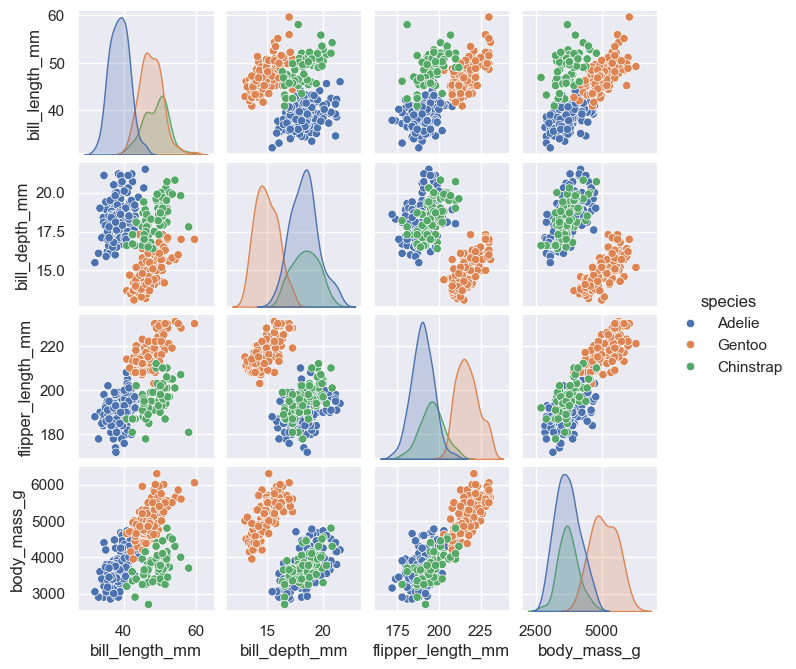

In [6]:
sns.set()
sns.pairplot(penguins, hue='species', height=1.7);

En la representación anterior cometí un error *sutil*. ¿Cuál es?

Para fines didácticos, simplificaremos el problema. 

- Unimos las categorías *'Adelie'* y *'Chinstrap'* en la clase *'adel_chins'*
- Además, usaremos datos estandarizados (más adelante, retomaremos éste concepto)

In [7]:
spec2 = penguins['species'].copy()
spec2[spec2.eq('Adelie') | spec2.eq('Chinstrap')] = 'adel_chins'
penguins['species'] = spec2
penguins

,species,island,bill_length_mm,bill_depth_mm,flipper_length_mm,body_mass_g,sex
0,adel_chins,Torgersen,39.1,18.7,181.0,3750.0,male
1,adel_chins,Torgersen,39.5,17.4,186.0,3800.0,female
2,adel_chins,Torgersen,40.3,18.0,195.0,3250.0,female
4,adel_chins,Torgersen,36.7,19.3,193.0,3450.0,female
5,adel_chins,Torgersen,39.3,20.6,190.0,3650.0,male
...,...,...,...,...,...,...,...
339,adel_chins,Dream,55.8,19.8,207.0,4000.0,male
340,adel_chins,Dream,43.5,18.1,202.0,3400.0,female
341,adel_chins,Dream,49.6,18.2,193.0,3775.0,male
342,adel_chins,Dream,50.8,19.0,210.0,4100.0,male


In [8]:
from sklearn.preprocessing import StandardScaler

col_vars = ['bill_length_mm', 'bill_depth_mm', 'flipper_length_mm', 'body_mass_g']
x_peng = penguins[col_vars]

ss = StandardScaler()
scaled_x = ss.fit_transform(x_peng)
scaled_x = pd.DataFrame(ss.fit_transform(x_peng), columns=col_vars, index = penguins.index)
penguins_sc = pd.concat([scaled_x, penguins['species']], axis=1)

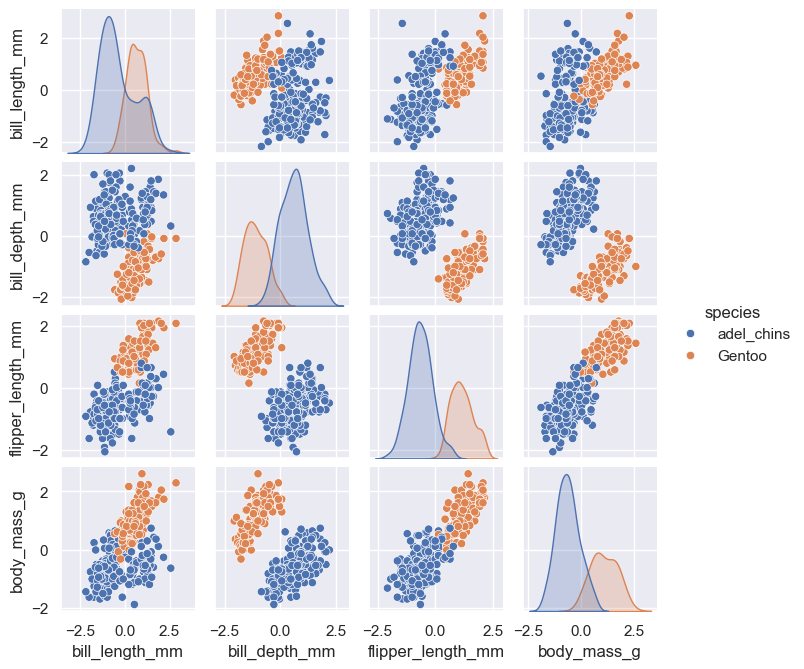

In [9]:
sns.pairplot(penguins_sc, hue='species', height=1.7);

Nuevamente, tenemos un problema de aprendizaje no supervisado. Podemos identificar claramente al menos 2 grupos


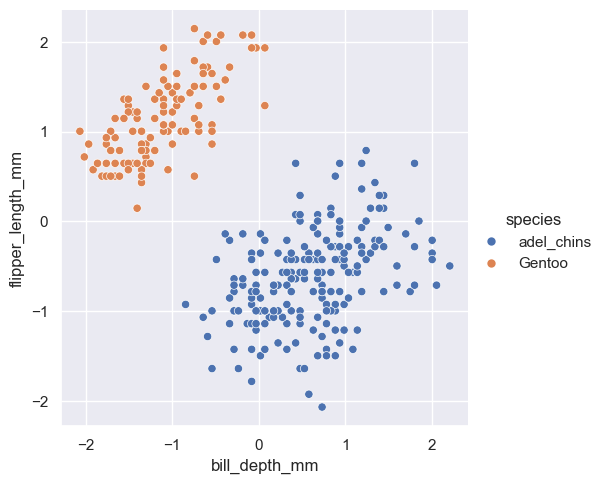

In [10]:
sns.relplot(x='bill_depth_mm', y='flipper_length_mm', hue='species', data=penguins_sc, height=5);

**Aprendizaje Supervisado**: aparece un dato nuevo y queremos saber a qué categoría pertenece

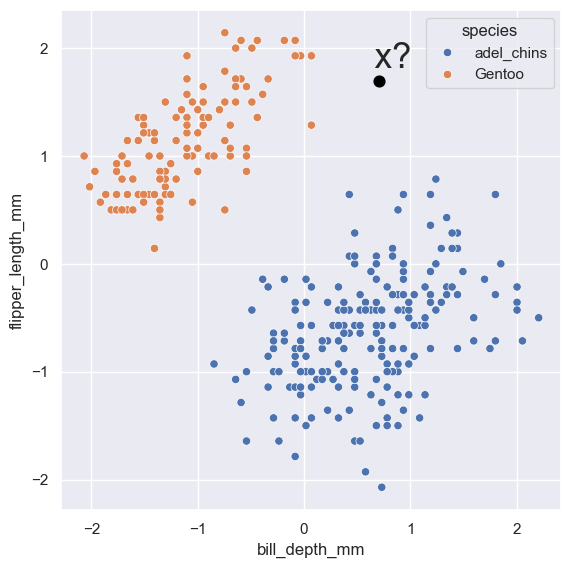

In [11]:
import matplotlib.pyplot as plt

new_x = [.7, 1.7]
fig = plt.figure(figsize = (5,5))
ax=fig.add_axes([0,0,1,1])
sns.scatterplot(x='bill_depth_mm', y='flipper_length_mm', hue='species', data=penguins_sc)
ax.scatter(x=new_x[0], y=new_x[1], color='black', s=60)
ax.text(new_x[0]-.13, new_x[1]+.12, ' x?', fontsize = 25);

¿Qué clase le asignarías? ¿Porqué?

Con lo que sabes o has aprendido hasta ahora, ¿se te ocurre algún método para estimar la clase del pinguino?

Tenemos entonces un conjunto de entrenamiento:

\begin{equation*}
(\mathbf{x}_1,y_1), \ldots ,(\mathbf{x}_n,y_n); \quad \mathbf{x} \in \mathbb{R}^2, y \in \left\lbrace -1,1 \right\rbrace
\end{equation*}

Queremos una función
\begin{equation*}
f:\mathbb{R}^2 \mapsto \left\lbrace -1,1 \right \rbrace
\end{equation*}

que nos responda la pregunta: ¿$\mathbf{x}_{new}$ es similar a Gentoo (-1) o a Adelie-Chinstrap ($+1$)?

Una solución basado en la distancia como medida de similaridad.

Usaremos un criterio basado en el vecino más cercano, pero en este caso, vamos a "*resumir*" los puntos de ambas categorías en solo 2 vecinos:

$\mathbf{c}_+ = \frac{1}{n_+} \sum_{i|y_i=1}\mathbf{x}_i$ 

y 

$\mathbf{c}_- = \frac{1}{n_-} \sum_{i|y_i=-1}\mathbf{x}_i$


In [12]:
x_gent = np.array(penguins_sc.loc[penguins_sc['species']=='Gentoo',['bill_depth_mm', 'flipper_length_mm']])
x_adel_chins = np.array(penguins_sc.loc[penguins_sc['species']!='Gentoo',['bill_depth_mm', 'flipper_length_mm']])
x_means = np.vstack((x_gent.mean(axis=0),x_adel_chins.mean(axis=0)))
all_mean = x_means.mean(axis=0)

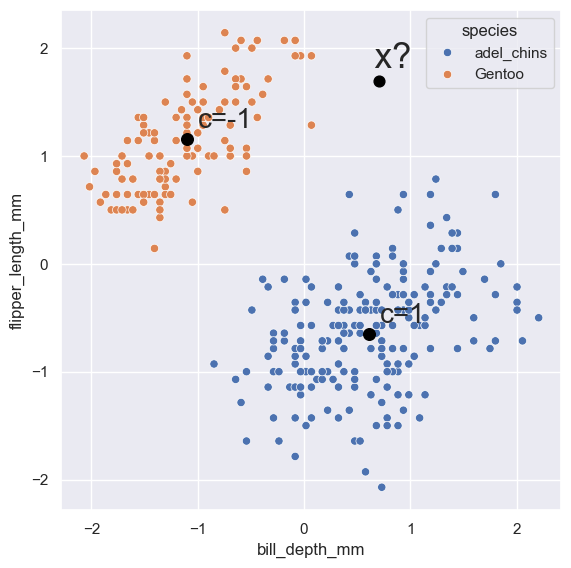

In [13]:
ax.scatter(x_means[:,0], x_means[:,1], color='black', s=70)
for i in range(0,x_means.shape[0]):
    ax.text(x_means[i,0]+.1, x_means[i,1]+.1, 'c='+str(round(2*i-1)), fontsize = 20)
fig

Entonces, nos interesa saber si

¿$\|\mathbf{c}_- - \mathbf{x} \|^2 > \|\mathbf{c}_+ - \mathbf{x} \|^2$ ?

equivalente a

¿$\|\mathbf{c}_-\|^2 - \|\mathbf{c}_+\|^2 + 2\langle\mathbf{x},\mathbf{c}_+\rangle - 2\langle\mathbf{x},\mathbf{c}_-\rangle > 0$?

Construimos un clasificador muy sencillo, para esto, define

$\mathbf{c}=(\mathbf{c}_+ - \mathbf{c}_-)/2$, 

$\qquad \mathbf{w}=\mathbf{c}_+ - \mathbf{c}_-$

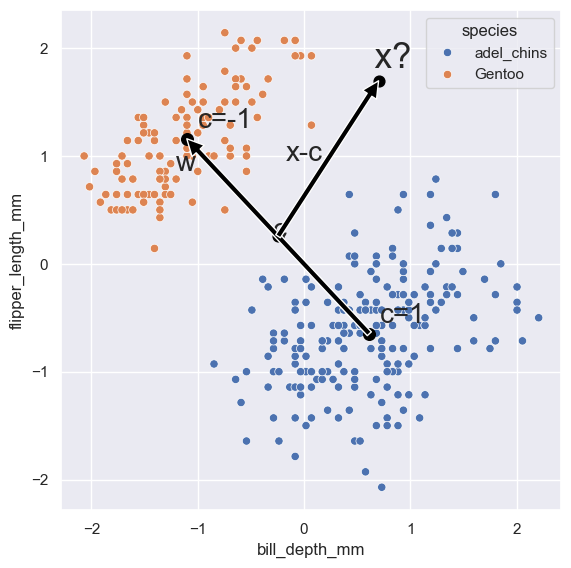

In [14]:
w = x_adel_chins.mean(axis=0)-x_gent.mean(axis=0)
ax.scatter(all_mean[0], all_mean[1], color='black', s=60)
ax.text(all_mean[0]-.05, all_mean[1]-.02, 'c', fontsize = 20)
ax.annotate('',xy = (x_means[0,0], x_means[0,1]), xytext = (x_means[1,0], x_means[1,1]),
               arrowprops=dict(facecolor='black'))
ax.text(x_means[0,0]-.1, x_means[0,1]-.3, 'w', fontsize = 20)
ax.annotate('',xy = (new_x[0], new_x[1]), xytext = (all_mean[0], all_mean[1]),
               arrowprops=dict(facecolor='black'))
ax.text(all_mean[0]+.07, all_mean[1]+.7, 'x-c', fontsize = 20)
fig

Lo anterior, induce un modelo lineal de clasificación:

$w_0+\mathbf{w}'\mathbf{x}$.

Entonces, podemos clasificar mediante

$y=\textrm{sign}\langle(\mathbf{x}-\mathbf{c}),\mathbf{w}\rangle$

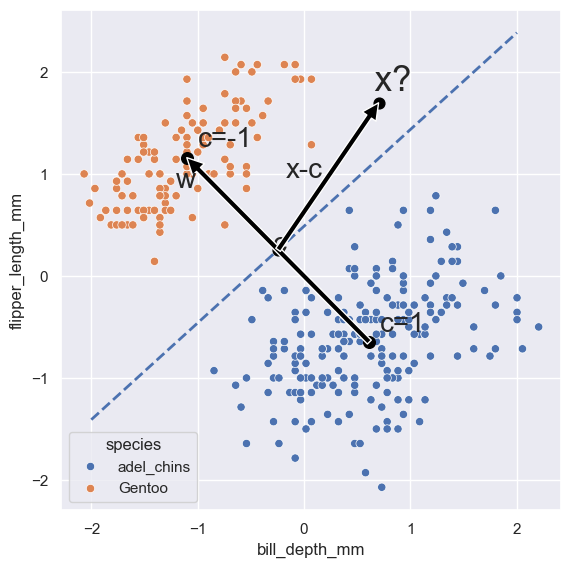

In [15]:
cg = x_gent.mean(axis=0)
cac = x_adel_chins.mean(axis=0)
w = cac-cg
w0 = (np.dot(cg,cg)-np.dot(cac,cac))*.5
xx1 = np.linspace(-2,2,100)
xx2 = -(w[0]*xx1+w0)/w[1]
ax.plot([xx1[0],xx1[99]],[xx2[0],xx2[99]],linestyle='--', linewidth=2)
fig

Obviamente, ésta solución no es la mejor opción. 

Por ejemplo, ¿qué pasa si tenemos outliers?

## Ejemplo 2. Digitos MNIST 

La base de datos está incluida en varios módulos (por ejemplo, `sklearn`), pero para usar la versión original de 28 x 28 pixeles, usaremos la que está contenida en el módulo `torchvision` de `pytorch`.

In [16]:
#import torch
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
from mnist_functions import *

%matplotlib inline

In [17]:
train_data = get_train_data()
temp, _ = train_data[0]
img_width, img_height = temp.squeeze(0).shape[0], temp.squeeze(0).shape[1]

scaler, pca1, x_pca1, y = get_pca_pixels(train_data, img_width, img_height, 10000,2)

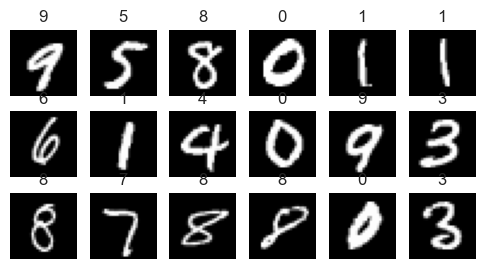

In [18]:
figure = plt.figure(figsize=(6, 3))
cols, rows = 6, 3
for i in range(1, cols * rows + 1):
    sample_idx = torch.randint(len(train_data), size=(1,)).item()
    img, label = train_data[sample_idx]
    figure.add_subplot(rows, cols, i)
    plt.title(label)
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray")

Considera ésta representación de los datos

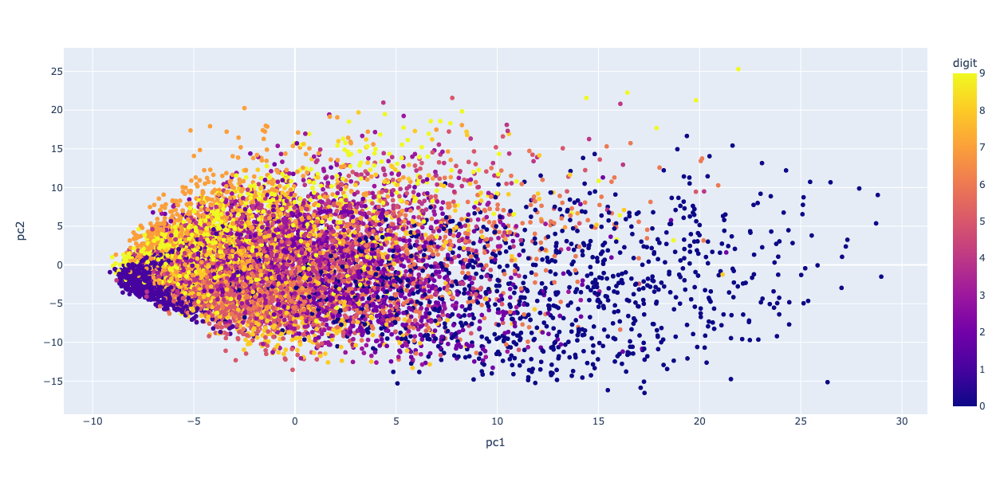

In [19]:
pca_dataset = pd.DataFrame({'pc1': x_pca1[:, 0], 'pc2': x_pca1[:, 1], 'digit': y})
fig = px.scatter(pca_dataset, x='pc1', y='pc2', color= 'digit', hover_data=['digit'])
fig.update_layout(autosize=False,width=600,height=600)
fig.show()

¿Qué tan útil es ésta representación?

Veámoslo con una aplicación interactiva...

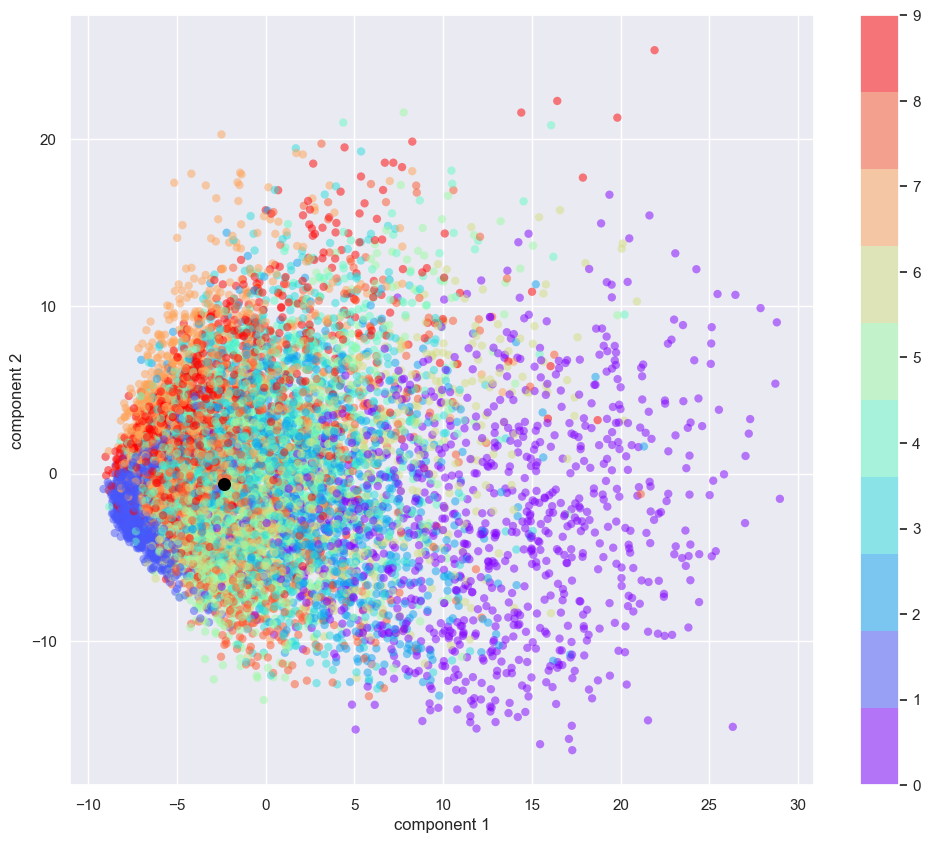

In [20]:
from digitsTab import *

# Load
model = simple_linear_classifier()
model.load_state_dict(torch.load('simple_linear_mnist.pt'))
model.eval()
# ejecutamos el applet
root = Tk()
root.geometry("500x400")
root.resizable(0, 0)
app = digits_representation(root, img_width, img_height, scaler, pca1, x_pca1, y, False, model)
root.mainloop()

Otra representación... compara con la anterior.

In [21]:
# Load
cnn = CNN()
cnn.load_state_dict(torch.load('cnn_mnist.pt'))
embeddings, labels = get_train_features(cnn)
scaler, pca, x_pca = get_pca(embeddings,3)

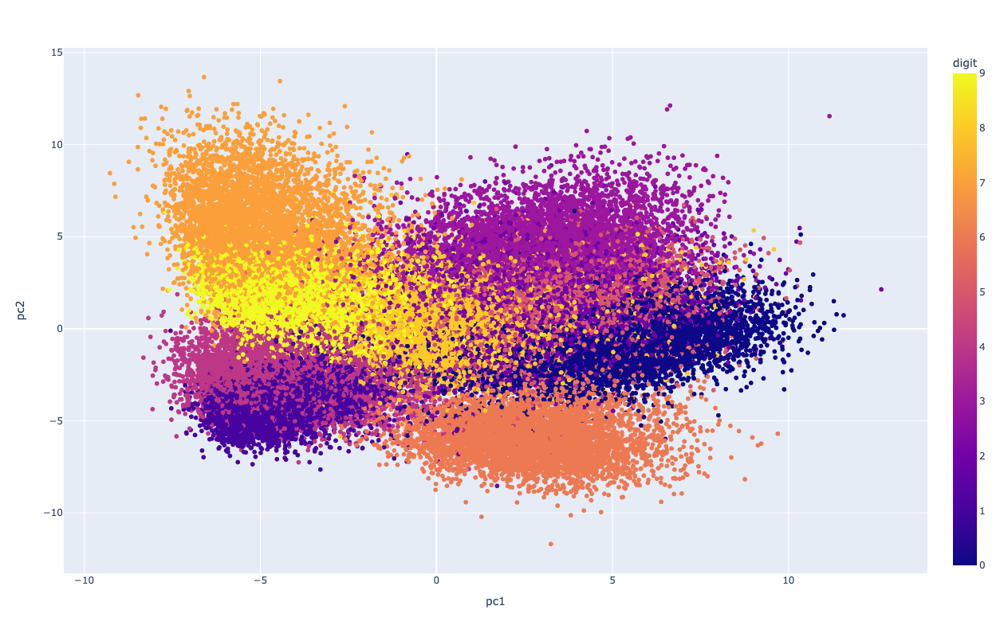

In [22]:
pca_dataset = pd.DataFrame({'pc1': x_pca[:, 0], 'pc2': x_pca[:, 1], 'pc3': x_pca[:, 2], 'digit': labels})
pca_dataset['column_for_size'] = 2
fig = px.scatter(pca_dataset, x='pc1', y='pc2', color= 'digit', hover_data=['digit'])
fig.update_layout(autosize=False,width=800,height=800)
#fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.show()

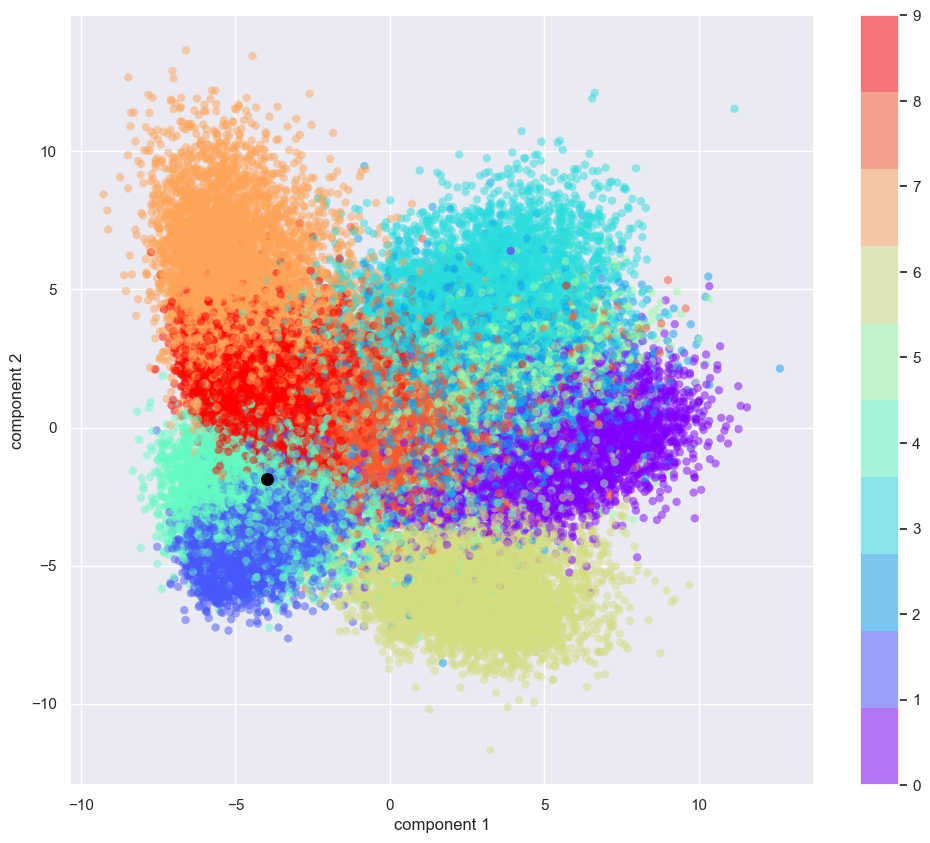

In [23]:
# ejecutamos el applet
root = Tk()
root.geometry("500x400")
root.resizable(0, 0)
app = digits_representation(root, img_width, img_height, scaler, pca, x_pca, labels, True, cnn)
root.mainloop()

## Ejemplo 3. Análisis de audio

<img src="../figs/music_band_audio.png" height="45%" width="45%" align="center"/>

Este código no se puede ejecutar, ya que se requiere tener los archivos de audio e implica una gran cantidad de memoria. Solo recuerda lo que vimos en clase.

In [ ]:
import numpy as np
import pandas as pd
import os
%matplotlib inline

from audio_scatter.plotly import create_player, play, audio_scatter

In [ ]:
#audio_path = '/Users/vmac/cursos/veranos/2023/notebooks/'
audio_path = '/Volumes/vic_backup/vic_backup/'

fma_data = pd.read_csv('../data/fma_umap_proj.csv',index_col=0)
fma_data['audio_path']=[audio_path+txt for txt in fma_data['audio_path']]
fma_data['audio_path']=[x.replace('"', '') for x in fma_data['audio_path']]
fma_data['start'] = 10
fma_data['stop'] = 14

audio_scatter(fma_data, start='start', stop='stop', color='genero', action='click', group = 'genero', width=900, height=700)

Veamos otro ejemplo

In [ ]:
audio_path = '/Users/vmac/cursos/veranos/2023/notebooks/'
harmony_data = pd.read_csv('../data/harmony_dataset_umap.csv',index_col=0)

harmony_data['audio_path']=[audio_path+'Autors/'+txt for txt in harmony_data['audio_path']]
harmony_data['audio_path']=[x.replace('"', '') for x in harmony_data['audio_path']]
harmony_data['start'] = 10
harmony_data['stop'] = 14
harmony_data.index.name='index'

audio_scatter(harmony_data, start='start', stop='stop', color='Autor', group = 'Autor', action='click', hover_data=['Corriente'], width=900, height=700)

## Ejemplo 4. Textos de opinión

<img src="../figs/text_opiniones.png" height="80%" width="80%" align="center"/>

Aquí, usaremos textos en español que corresponden a opiniones de usuarios en los siguientes productos: automóviles, hoteles, lavadoras, libros, teléfonos celulares, música, computadoras y películas (Julian Brooke and Maite Taboada. https://www.sfu.ca/~mtaboada/SFU_Review_Corpus.html).

No todo el código lo vas a poder ejecutar, ya que faltan varias cosas que en éste momento no es importante saber (algunas las veremos posteriormente en el curso). Fijate solo en la idea del ejemplo...

In [3]:
from sklearn.feature_extraction.text import CountVectorizer
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
import my_functions
from my_functions import *

t_data = pd.read_csv('../data/spanish_reviews/reviews_text_caract.csv', header=0)
t_data

,file,categoria,sentimiento
0,coches_no_1_11.txt,coches,no
1,coches_no_1_13.txt,coches,no
2,coches_no_1_15.txt,coches,no
3,coches_no_1_18.txt,coches,no
4,coches_no_1_19.txt,coches,no
...,...,...,...
395,peliculas_yes_5_23.txt,peliculas,yes
396,peliculas_yes_5_4.txt,peliculas,yes
397,peliculas_yes_5_5.txt,peliculas,yes
398,peliculas_yes_5_7.txt,peliculas,yes


In [4]:
dir_data = '../data/spanish_reviews/all_files/'
# leer y preprocesar textos
preprocesador = preprocesaTexto(idioma='es', _tokeniza=False, _muestraCambios=False, _quitarAcentos=True, 
                                _remueveStop=True, _stemming=False,_lematiza=False)

files_txt = dir_data+t_data['file']
files_txt = files_txt.tolist()

corpus = []
raw_txt = []
for f in files_txt:
    file = open(f, 'r', encoding='latin-1')
    txt = file.read()
    raw_txt.append(txt)
    txt_prep = preprocesador.preprocesa(txt)
    corpus.append(txt_prep)

y1 = t_data['categoria'].astype('category').cat.codes
y2 = t_data['sentimiento'].astype('category').cat.codes

Veamos algunos ejemplos del corpus, tanto el original como el preprocesado.

In [5]:
raw_txt[10]

'Hola a todos. Tengo un Scenic RX4 con dos años y medio y 60.000 Km. La mayoría de defectos que citan los "desilusionados" los he tenido yo también: me entregaron el coche con un fallo del turbo (no me creo que le hicieran revisión pre-entrega, o si la hicieron les dió igual darme el coche con la avería. sic), rotura del turbo con 55.000 Km (pese a estar fuera de garantía por kilometraje, Renault se hizo cargo del 80%. "Solo" pagué 300 euros), infinitos fallos con el sensor de presión de los neumáticos (reconozco que es una chorrada de avería, pero me obligó a llevar el coche al concesionario al menos 6 veces), el sistema de anclaje de la tapa de la gasolina y el motor del cierre de esta, están hechos para que se rompan al poco tiempo (solo hay que verlo) y por último el famoso sistema de escape. Me han cambiado 2 veces el catalizador, dos veces el tramo intermedio y una el silencioso final. Acoples y cambios en el diseño del escape no han servido de nada y todas las semanas reviso los

In [6]:
corpus[10]

'hola scenic rx dos años medio km mayoria defectos citan desilusionados entregaron coche fallo turbo creo hicieran revision preentrega si hicieron dio igual darme coche averia sic rotura turbo km pese garantia kilometraje renault hizo cargo solo pague euros infinitos fallos sensor presion neumaticos reconozco chorrada averia obligo llevar coche concesionario menos veces sistema anclaje tapa gasolina motor cierre hechos rompan tiempo solo verlo ultimo famoso sistema escape cambiado veces catalizador dos veces tramo intermedio silencioso final acoples cambios diseño escape servido todas semanas reviso bajos coche si miedo pusieran bomba vaya solo conozco caso propietario vehiculo roto verdad aun pocos km conozco personalmente casos peores fundidas embrague roturas suspensiones etc espero afecten unidad fin coche bonito malo si renault dejado fabricarlo honor verdad decir salvo tapa gasolina reparacion turbo resto reparaciones hecho cargo renault incluso producido periodo garantia sintoma

Veamos una forma de representación. (NO EJECUTAR...)

In [7]:
from gensim.models.keyedvectors import KeyedVectors
wordvectors_file_vec = '../../banxico/nlp_2020/data/fasttext-sbwc.vec'
size_w = 100000
wordvectors = KeyedVectors.load_word2vec_format(wordvectors_file_vec)

In [8]:
def frase_a_vec(frase, modelo_wv):
    N = 0
    acc = np.zeros(modelo_wv.vector_size)
    for palabra in frase:
        if palabra in modelo_wv.key_to_index:
            acc += modelo_wv[palabra]
            N += 1
    return acc if N==0 else acc/N

def sentencias_a_vec(frases, modelo_wv):
    vectores = np.zeros((len(frases), modelo_wv.vector_size))
    for (i, frase) in enumerate(frases):
        vectores[i,:] = frase_a_vec(frase, modelo_wv)
    return vectores

In [9]:
docs_vec = np.zeros((len(corpus), wordvectors.vector_size))

for (i, txt) in enumerate(corpus):
    tokens = word_tokenize(txt)
    docs_vec[i,:] = frase_a_vec(tokens, wordvectors)

In [10]:
from sklearn.decomposition import PCA, KernelPCA
from sklearn.preprocessing import StandardScaler
import plotly.express as px

X = StandardScaler().fit_transform(docs_vec)
pca = PCA(n_components=5)
docs_pca = pca.fit_transform(X)
proj = pd.DataFrame(docs_pca,columns = ['pc1','pc2','pc3','pc4','pc5'])

proj_docs = pd.DataFrame({'pc1': proj['pc1'], 'pc2': proj['pc2'], 'pc3': proj['pc3'], 'topico': t_data['categoria'],
                       'sentimiento':t_data['sentimiento']})

Visualmente, obtenemos lo siguiente. Observa cómo se ve respecto al tópico y al sentimiento.

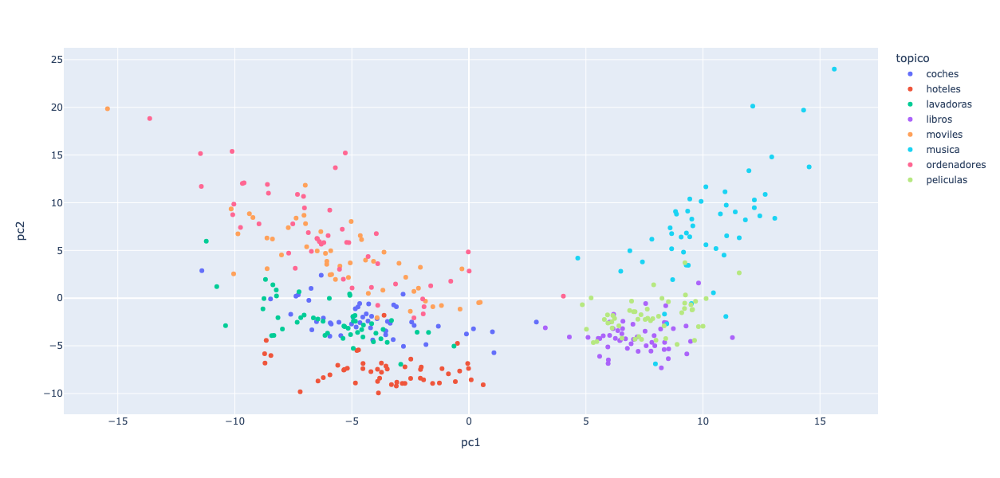

In [11]:
fig = px.scatter(proj_docs, x='pc1', y='pc2', hover_data=['sentimiento'], color = 'topico')
fig.update_layout(
    autosize=False,
    width=600,
    height=600,
)
fig.show()

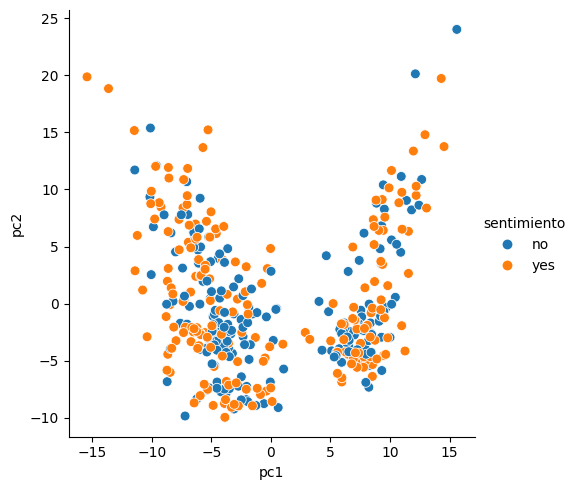

In [14]:
sns.relplot(x='pc1', y='pc2', hue='sentimiento', data=proj_docs, height=5, s=50)
plt.show()